In [ ]:
!nvidia-smi


Fri Dec 26 05:46:46 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   38C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
!pip install kaggle


In [ ]:
!pip install ultralytics


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls /content/drive/MyDrive


'2025-08-14 12-47-26.pdf'   fruit_yolov8_improved2  'توقيع العقد.pdf'
'Colab Notebooks'	    fruit_yolov8_improved3  'مروة صعر.pdf'
 DOC-20250814-WA0005..pdf   fruit_yolov8_improved4  'نسخة من store_sales_1.csv'
 fruit-detection	    fruit_yolov8_improved5
 fruit_yolov8_improved	    fruit_yolov8_improved6


In [ ]:
!cp -r /content/drive/MyDrive/fruit-detection /content/


In [ ]:
!rsync -ah --progress /content/drive/MyDrive/fruit-detection /content/


Streaming output truncated to the last 5000 lines.
             39 100%    0.04kB/s    0:00:00 (xfr#14469, to-chk=2500/16977)
fruit-detection/train/labels/dd6a32d6f8679f11_jpg.rf.be6a492cde27685d160c8e792ee8795f.txt
             40 100%    0.04kB/s    0:00:00 (xfr#14470, to-chk=2499/16977)
fruit-detection/train/labels/dd787d52f48ac68f_jpg.rf.083027dfca1e4c8db182f5d7b97f9513.txt
            133 100%    0.15kB/s    0:00:00 (xfr#14471, to-chk=2498/16977)
fruit-detection/train/labels/dd787d52f48ac68f_jpg.rf.92096d9e7e2c0cbcb8efd32229502e12.txt
            132 100%    0.15kB/s    0:00:00 (xfr#14472, to-chk=2497/16977)
fruit-detection/train/labels/dd787d52f48ac68f_jpg.rf.ed264d9ad5baf4aa6503df5e5a0846b1.txt
            131 100%    0.14kB/s    0:00:00 (xfr#14473, to-chk=2496/16977)
fruit-detection/train/labels/dd98a56448ca8666_jpg.rf.08f1568dee174997f81e69922c4f4ca3.txt
             38 100%    0.04kB/s    0:00:00 (xfr#14474, to-chk=2495/16977)
fruit-detection/train/labels/dd98a56448ca8666_jpg

In [ ]:
import os
print(os.listdir("/content/fruit-detection"))


['yolov8s.pt', 'train', 'cli.log', 'valid', '1.archive', 'data.yaml', 'README.txt', 'test']


In [ ]:
!pip install ultralytics --quiet


In [ ]:
from ultralytics import YOLO
import os

# مسار البيانات
data_dir = "/content/fruit-detection"
data_yaml_path = os.path.join(data_dir, "data.yaml")

print("مسار البيانات:", data_dir)
print("ملف YAML:", data_yaml_path)


In [ ]:
model = YOLO("yolov8s.pt")  # يمكنك تغييره إذا أردت موديل أكبر


In [ ]:
data_yaml_path = "/content/fruit-detection/data.yaml"

with open(data_yaml_path, "r") as f:
    print(f.read())


In [ ]:
data_yaml_path = "/content/fruit-detection/data.yaml"

yaml_content = """
names:
- Apple
- Banana
- Grape
- Orange
- Pineapple
- Watermelon
nc: 6
train: /content/fruit-detection/train/images
val: /content/fruit-detection/valid/images
test: /content/fruit-detection/test/images
"""

with open(data_yaml_path, "w") as f:
    f.write(yaml_content)

print("تم تعديل data.yaml بنجاح!")


In [ ]:
data_yaml_path = "/content/fruit-detection/data.yaml"

with open(data_yaml_path, "r") as f:
    content = f.read()

print(content)



names:
- Apple
- Banana
- Grape
- Orange
- Pineapple
- Watermelon
nc: 6
train: /content/fruit-detection/train/images
val: /content/fruit-detection/valid/images
test: /content/fruit-detection/test/images



In [ ]:
import os

print("عدد صور التدريب:", len(os.listdir("/content/fruit-detection/train/images")))
print("عدد صور التحقق:", len(os.listdir("/content/fruit-detection/valid/images")))
print("عدد صور الاختبار:", len(os.listdir("/content/fruit-detection/test/images")))


عدد صور التدريب: 7110
عدد صور التحقق: 914
عدد صور الاختبار: 457


In [ ]:
DATASET_PATH = "/content/fruit-detection"

data_yaml = f"""
train: {DATASET_PATH}/train/images
val: {DATASET_PATH}/valid/images
test: {DATASET_PATH}/test/images

nc: 6
names: ['Apple', 'Banana', 'Grape', 'Orange', 'Pineapple', 'Watermelon']
"""

with open("data.yaml", "w") as f:
    f.write(data_yaml)

# تحقق أن الملف موجود
!ls -l


total 22076
-rw-r--r-- 1 root root      212 Dec 26 05:58 data.yaml
drwx------ 5 root root     4096 Dec 26 05:45 drive
drwx------ 5 root root     4096 Dec 25 11:31 fruit-detection
drwxr-xr-x 1 root root     4096 Dec  9 14:42 sample_data
-rw-r--r-- 1 root root 22588772 Dec 26 05:58 yolov8s.pt


In [ ]:
model.train(
    data="/content/data.yaml",  # استخدم المسار الكامل
    epochs=50,
    imgsz=640,
    batch=16,
    name="fruit_yolov8",
    patience=10
)


Ultralytics 8.3.241 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=fruit_yolov8, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0.0, plots=True, pose=12.0,

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d0dfa2cbaa0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
     

In [ ]:
import os
os.listdir("/content/runs/detect/fruit_yolov8/weights/")


['best.pt', 'last.pt']

In [ ]:
import os
import shutil

# إنشاء المجلد على Drive إذا لم يكن موجود
os.makedirs("/content/drive/MyDrive/fruit_yolov8", exist_ok=True)

# المسار الأصلي للنموذج
src = "/content/runs/detect/fruit_yolov8/weights/best.pt"

# المسار الجديد على Drive
dst = "/content/drive/MyDrive/fruit_yolov8/best.pt"

# نسخ النموذج
shutil.copy(src, dst)
print("تم حفظ النموذج على Google Drive بنجاح!")


تم حفظ النموذج على Google Drive بنجاح!


In [ ]:
import os
import shutil

# 1️⃣ إنشاء مجلد لحفظ كل شيء على Drive
save_dir = "/content/drive/MyDrive/fruit_yolov8_full_results"
os.makedirs(save_dir, exist_ok=True)

# 2️⃣ مسار مجلد النتائج من التدريب
results_dir = "/content/runs/detect/fruit_yolov8"

# 3️⃣ نسخ المجلد كله إلى Drive
shutil.copytree(results_dir, save_dir, dirs_exist_ok=True)

print(f"تم حفظ كل ملفات النتائج والنموذج في: {save_dir}")


تم حفظ كل ملفات النتائج والنموذج في: /content/drive/MyDrive/fruit_yolov8_full_results


In [ ]:
from ultralytics import YOLO
import cv2
from matplotlib import pyplot as plt
import os

# 1️⃣ تحميل النموذج المحفوظ من Google Drive
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة التي تريد التنبؤ عليها
TEST_IMAGES = "/content/fruit-detection/test/images"

# 3️⃣ عرض أول 5 صور مع التنبؤات
for i, img_file in enumerate(os.listdir(TEST_IMAGES)):
    if i >= 5:  # فقط أول 5 صور للعرض
        break
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # عرض الصورة
    plt.figure(figsize=(10, 8))
    plt.imshow(result_img)
    plt.title(img_file)
    plt.axis('off')
    plt.show()


ModuleNotFoundError: No module named 'ultralytics'

In [ ]:
from ultralytics import YOLO
import os
from matplotlib import pyplot as plt

# 1️⃣ تحميل النموذج
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة
TEST_IMAGES = "/content/fruit-detection/test/images"

# 3️⃣ مجلد لحفظ الصور بعد التنبؤ
OUTPUT_DIR = "/content/fruit-detection/test/predicted_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)  # إنشاء المجلد إذا لم يكن موجودًا

# 4️⃣ التنبؤ وحفظ الصور
for i, img_file in enumerate(sorted(os.listdir(TEST_IMAGES))):
    if i >= 10:  # فقط أول 10 صور كمثال
        break
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path, conf=0.25, save=False)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # حفظ الصورة
    output_path = os.path.join(OUTPUT_DIR, img_file)
    # matplotlib يستخدم RGB، لذلك نحتاج حفظ الصورة باستخدام plt
    plt.imsave(output_path, result_img)

    print(f"تم حفظ الصورة المتنبأ عليها في: {output_path}")



image 1/1 /content/fruit-detection/test/images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg: 640x640 1 Watermelon, 16.3ms
Speed: 2.2ms preprocess, 16.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
تم حفظ الصورة المتنبأ عليها في: /content/fruit-detection/test/predicted_images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg

image 1/1 /content/fruit-detection/test/images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg: 640x640 1 Apple, 16.3ms
Speed: 2.0ms preprocess, 16.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
تم حفظ الصورة المتنبأ عليها في: /content/fruit-detection/test/predicted_images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg

image 1/1 /content/fruit-detection/test/images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg: 640x640 1 Orange, 17.5ms
Speed: 3.0ms preprocess, 17.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
تم حفظ الصورة المتنبأ

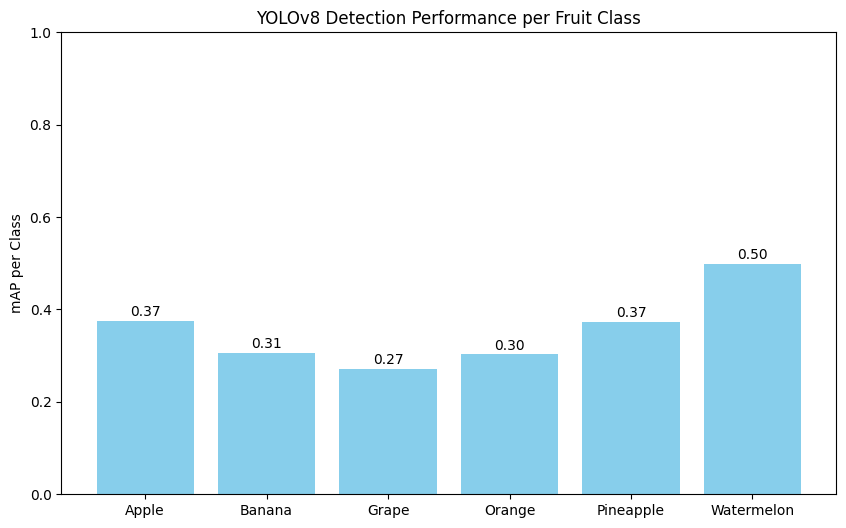

In [ ]:
import matplotlib.pyplot as plt

# أسماء الأصناف
class_names = ['Apple', 'Banana', 'Grape', 'Orange', 'Pineapple', 'Watermelon']

# mAP لكل صنف (قيمك من النتائج)
maps = [0.37499, 0.30594, 0.27169, 0.30303, 0.37349, 0.49834]

# رسم شريط لكل صنف
plt.figure(figsize=(10,6))
bars = plt.bar(class_names, maps, color='skyblue')
plt.ylim(0, 1)
plt.ylabel('mAP per Class')
plt.title('YOLOv8 Detection Performance per Fruit Class')

# إضافة القيم أعلى الأعمدة
for bar, value in zip(bars, maps):
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01, f'{value:.2f}', ha='center', fontsize=10)

plt.show()


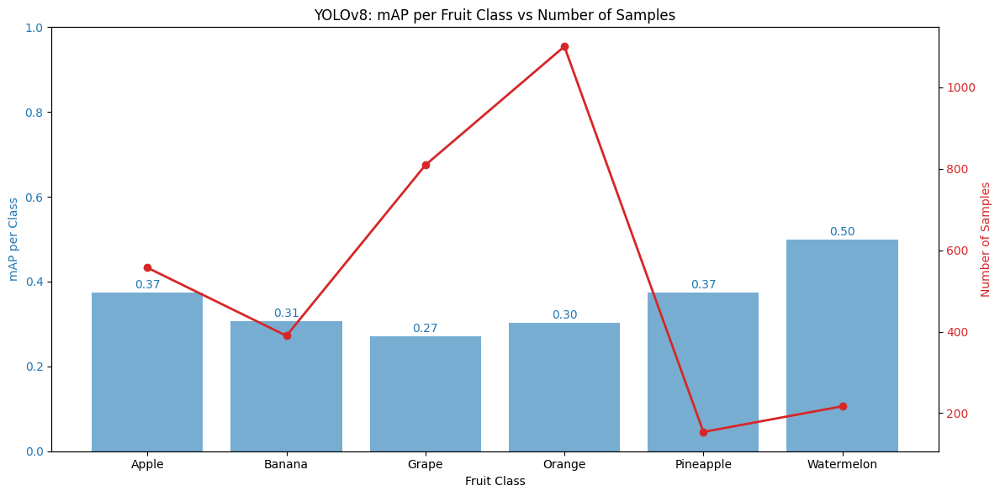

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# أسماء الأصناف
class_names = ['Apple', 'Banana', 'Grape', 'Orange', 'Pineapple', 'Watermelon']

# mAP لكل صنف
maps = [0.37499, 0.30594, 0.27169, 0.30303, 0.37349, 0.49834]

# عدد العينات لكل صنف
num_samples = [557, 390, 809, 1100, 154, 217]

# إنشاء الشكل والمحاور
fig, ax1 = plt.subplots(figsize=(12,6))

# المحور الأول: mAP لكل صنف
color = 'tab:blue'
ax1.set_xlabel('Fruit Class')
ax1.set_ylabel('mAP per Class', color=color)
bars = ax1.bar(class_names, maps, color=color, alpha=0.6, label='mAP')
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_ylim(0, 1)

# إضافة قيم mAP أعلى الأعمدة
for bar, value in zip(bars, maps):
    ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01, f'{value:.2f}', ha='center', color=color)

# المحور الثاني: عدد العينات لكل صنف
ax2 = ax1.twinx()
color = 'tab:red'
ax2.set_ylabel('Number of Samples', color=color)
ax2.plot(class_names, num_samples, color=color, marker='o', linewidth=2, label='Num Samples')
ax2.tick_params(axis='y', labelcolor=color)

# عنوان ومظهر نهائي
plt.title('YOLOv8: mAP per Fruit Class vs Number of Samples')
fig.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np

# أسماء الأصناف
class_names = ['Apple', 'Banana', 'Grape', 'Orange', 'Pineapple', 'Watermelon']

# mAP لكل صنف
maps = [0.37499, 0.30594, 0.27169, 0.30303, 0.37349, 0.49834]

# عدد العينات لكل صنف
num_samples = [557, 390, 809, 1100, 154, 217]

# نحسب الأداء المتوقع بناءً على عدد العينات (نسبة خطية بسيطة)
# normalize عدد العينات
norm_samples = np.array(num_samples) / max(num_samples)
expected_map = norm_samples * max(maps)  # نقيس توقع الأداء بشكل تقريبي

# حساب الفارق بين الأداء الفعلي والمتوقع
diff = np.array(maps) - expected_map

# إنشاء DataFrame
df = pd.DataFrame({
    'Class': class_names,
    'Num_Samples': num_samples,
    'mAP': maps,
    'Expected_mAP': expected_map,
    'Difference (Actual - Expected)': diff
})

# ترتيب الجدول حسب الفارق (الأكثر احتياجًا للتحسين أولاً)
df_sorted = df.sort_values(by='Difference (Actual - Expected)')

# عرض الجدول
df_sorted


,Class,Num_Samples,mAP,Expected_mAP,Difference (Actual - Expected)
3,Orange,1100,0.30303,0.498340,-0.195310
2,Grape,809,0.27169,0.366506,-0.094816
0,Apple,557,0.37499,0.252341,0.122649
1,Banana,390,0.30594,0.176684,0.129256
4,Pineapple,154,0.37349,0.069768,0.303722
5,Watermelon,217,0.49834,0.098309,0.400031


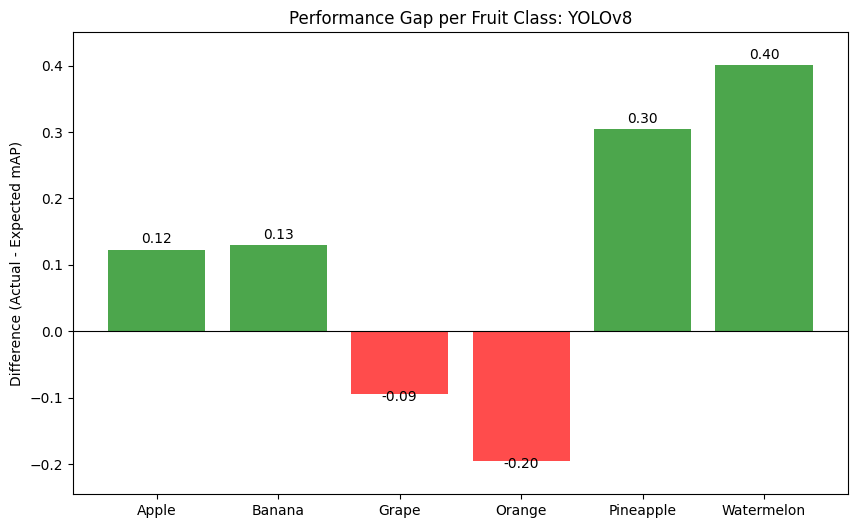

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# أسماء الأصناف
class_names = ['Apple', 'Banana', 'Grape', 'Orange', 'Pineapple', 'Watermelon']

# mAP لكل صنف
maps = np.array([0.37499, 0.30594, 0.27169, 0.30303, 0.37349, 0.49834])

# عدد العينات لكل صنف
num_samples = np.array([557, 390, 809, 1100, 154, 217])

# الأداء المتوقع بناءً على عدد العينات (نسبة خطية بسيطة)
norm_samples = num_samples / max(num_samples)
expected_map = norm_samples * max(maps)

# الفارق
diff = maps - expected_map

# تحديد الألوان: الأصناف التي أداؤها أقل من المتوقع باللون أحمر، أفضل أو مساوي باللون أخضر
colors = ['red' if d < 0 else 'green' for d in diff]

# إنشاء الرسم
plt.figure(figsize=(10,6))
bars = plt.bar(class_names, diff, color=colors, alpha=0.7)
plt.axhline(0, color='black', linewidth=0.8)  # خط الصفر للفارق
plt.ylabel('Difference (Actual - Expected mAP)')
plt.title('Performance Gap per Fruit Class: YOLOv8')
plt.ylim(min(diff)-0.05, max(diff)+0.05)

# إضافة القيم أعلى الأعمدة
for bar, value in zip(bars, diff):
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01 * np.sign(value), f'{value:.2f}', ha='center')

plt.show()


In [4]:
!pip install ultralytics --upgrade


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 19.0 MB/s eta 0:00:00


In [5]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [6]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
import os

# استبدل 'fruit_dataset' باسم المجلد الذي يحتوي على الصور
base_dir = "/content/drive/MyDrive/"
for root, dirs, files in os.walk(base_dir):
    if 'images' in dirs:
        print("Found 'images' folder at:", os.path.join(root, 'images'))


Found 'images' folder at: /content/drive/MyDrive/fruit-detection/valid/images
Found 'images' folder at: /content/drive/MyDrive/fruit-detection/test/images
Found 'images' folder at: /content/drive/MyDrive/fruit-detection/train/images
Found 'images' folder at: /content/drive/MyDrive/fruit-detection/train_subset/images
Found 'images' folder at: /content/drive/MyDrive/fruit-detection/train_subset_fast/images


In [8]:
from ultralytics import YOLO
import os
from matplotlib import pyplot as plt

# 1️⃣ تحميل النموذج
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة
TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# 3️⃣ مجلد لحفظ الصور بعد التنبؤ
OUTPUT_DIR = "/content/drive/MyDrive/fruit-detection/test/predicted_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# 4️⃣ التنبؤ وحفظ الصور (أول 10 صور)
for i, img_file in enumerate(sorted(os.listdir(TEST_IMAGES))):
    if i >= 10:  # فقط أول 10 صور
        break
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path, conf=0.25, save=False)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # حفظ الصورة
    output_path = os.path.join(OUTPUT_DIR, img_file)
    plt.imsave(output_path, result_img)

    print(f"✅ تم حفظ الصورة المتنبأ عليها في: {output_path}")



image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg: 640x640 1 Watermelon, 916.4ms
Speed: 11.5ms preprocess, 916.4ms inference, 57.9ms postprocess per image at shape (1, 3, 640, 640)
✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg: 640x640 1 Apple, 771.9ms
Speed: 9.4ms preprocess, 771.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)
✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg: 640x640 1 Orange, 1101.4ms
Speed: 15.3ms preprocess, 1101.4ms i


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg: 640x640 1 Watermelon, 636.2ms
Speed: 2.4ms preprocess, 636.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


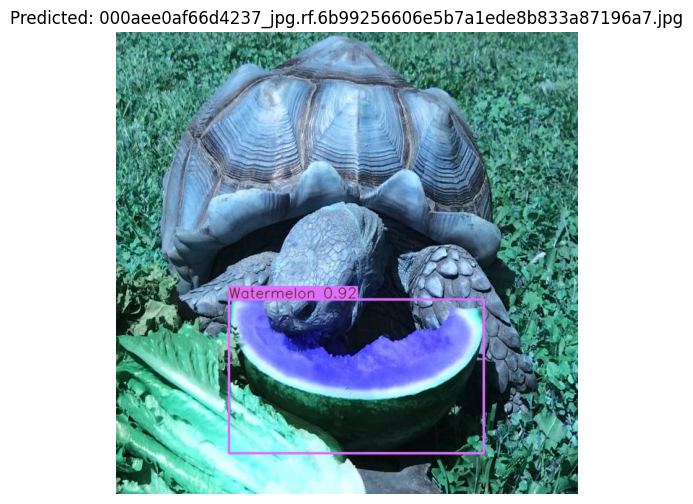

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg: 640x640 1 Apple, 680.0ms
Speed: 11.7ms preprocess, 680.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


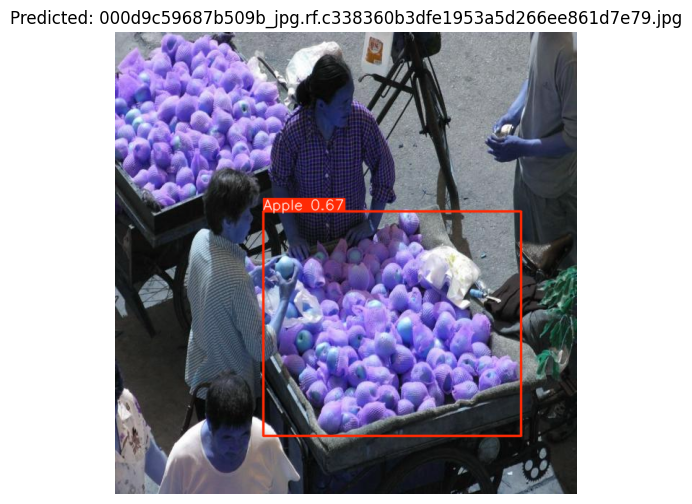

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg: 640x640 1 Orange, 705.7ms
Speed: 5.3ms preprocess, 705.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


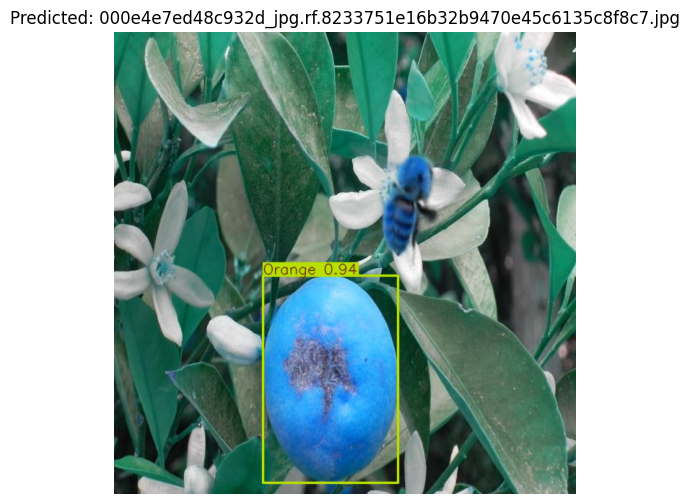

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00149fd0a01cc623_jpg.rf.68e2b35f1bc31938c4a10d32a8f5340e.jpg: 640x640 1 Orange, 1 Watermelon, 744.2ms
Speed: 3.8ms preprocess, 744.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


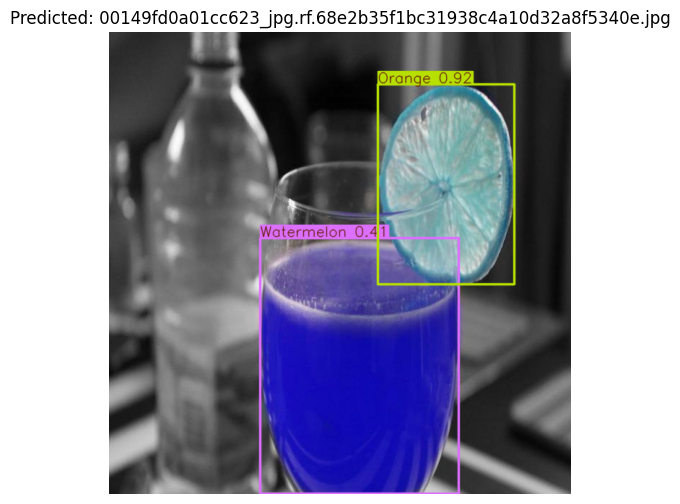

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/00149fd0a01cc623_jpg.rf.68e2b35f1bc31938c4a10d32a8f5340e.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/006e0a3d99d16d60_jpg.rf.258f5af33beab4d59918218c732de430.jpg: 640x640 1 Grape, 1663.6ms
Speed: 8.3ms preprocess, 1663.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


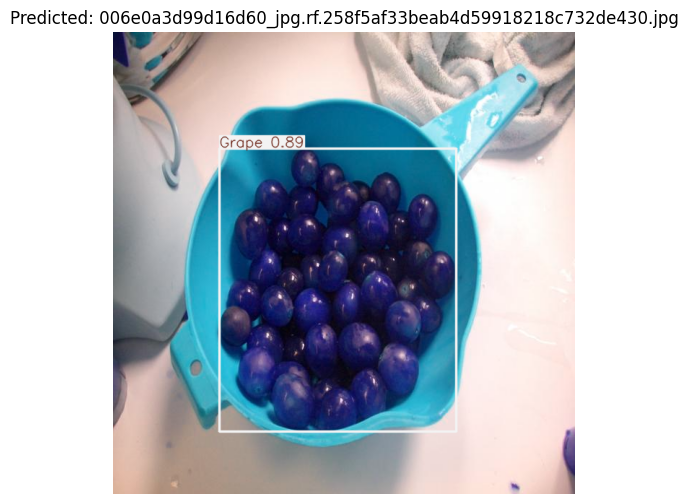

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/006e0a3d99d16d60_jpg.rf.258f5af33beab4d59918218c732de430.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/0074691e66aa85c0_jpg.rf.2fc1e81bbe5377b89f9c912c52ff7905.jpg: 640x640 1 Apple, 1 Orange, 700.8ms
Speed: 3.2ms preprocess, 700.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


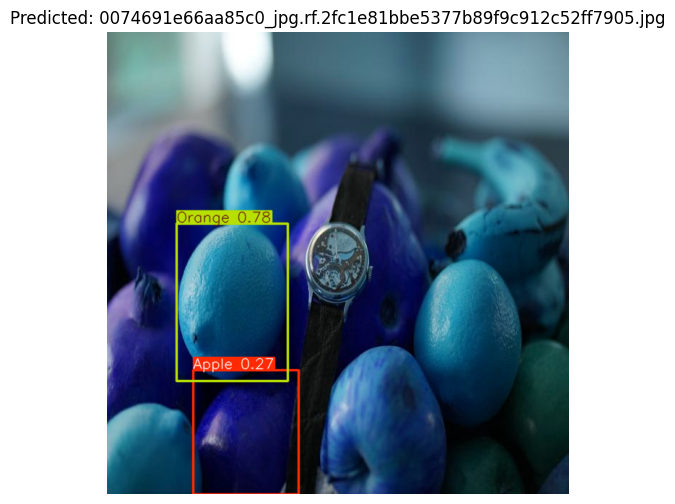

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/0074691e66aa85c0_jpg.rf.2fc1e81bbe5377b89f9c912c52ff7905.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/009b02d58c46ed73_jpg.rf.923b83d2b5656ae821e1e32781393aa2.jpg: 640x640 1 Grape, 687.1ms
Speed: 3.6ms preprocess, 687.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


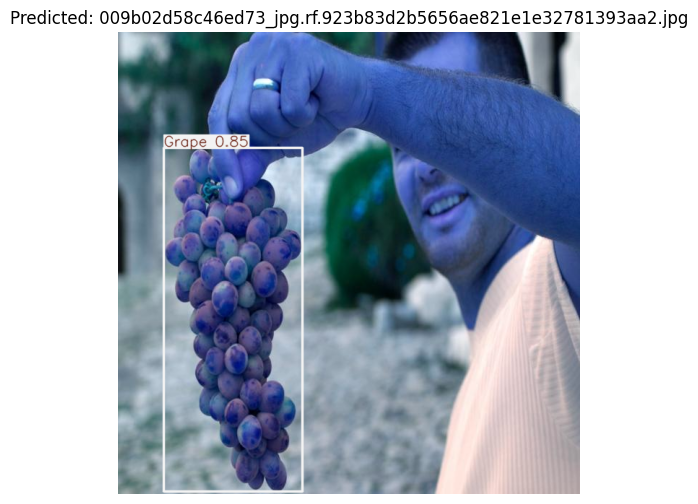

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/009b02d58c46ed73_jpg.rf.923b83d2b5656ae821e1e32781393aa2.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00a5ae275e1ebe39_jpg.rf.be4ae1c307aaeaa6d46752808eda2ad8.jpg: 640x640 2 Grapes, 682.0ms
Speed: 7.0ms preprocess, 682.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


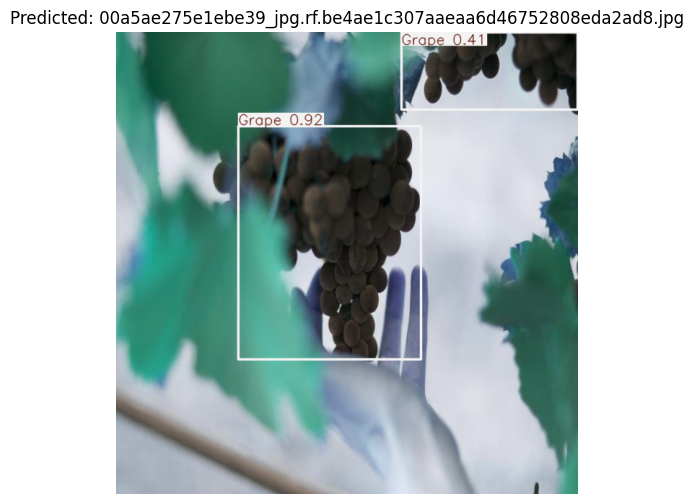

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/00a5ae275e1ebe39_jpg.rf.be4ae1c307aaeaa6d46752808eda2ad8.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00a70c466ad1fe24_jpg.rf.cf298c47a082719e705775c1ec343775.jpg: 640x640 1 Orange, 1 Pineapple, 677.6ms
Speed: 3.2ms preprocess, 677.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


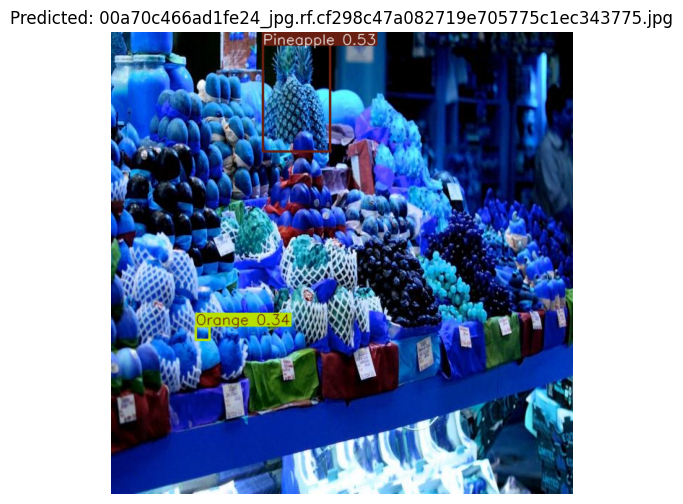

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/00a70c466ad1fe24_jpg.rf.cf298c47a082719e705775c1ec343775.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00b7cee6cbe6af50_jpg.rf.3a3cae04aadca322e29eafacce1af649.jpg: 640x640 2 Apples, 708.3ms
Speed: 3.3ms preprocess, 708.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


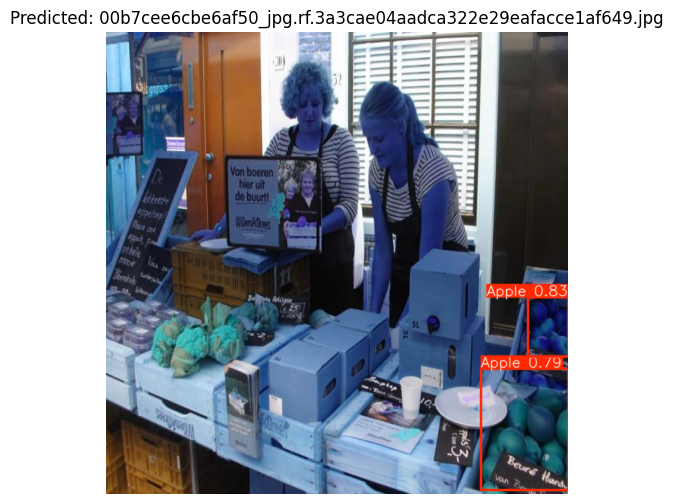

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/00b7cee6cbe6af50_jpg.rf.3a3cae04aadca322e29eafacce1af649.jpg


In [9]:
from ultralytics import YOLO
import os
from matplotlib import pyplot as plt

# 1️⃣ تحميل النموذج
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة
TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# 3️⃣ مجلد لحفظ الصور بعد التنبؤ
OUTPUT_DIR = "/content/drive/MyDrive/fruit-detection/test/predicted_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# 4️⃣ التنبؤ وحفظ الصور وعرضها
for i, img_file in enumerate(sorted(os.listdir(TEST_IMAGES))):
    if i >= 10:  # فقط أول 10 صور
        break
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path, conf=0.25, save=False)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # حفظ الصورة
    output_path = os.path.join(OUTPUT_DIR, img_file)
    plt.imsave(output_path, result_img)

    # عرض الصورة مباشرة داخل Colab
    plt.figure(figsize=(8,6))
    plt.imshow(result_img)
    plt.title(f"Predicted: {img_file}")
    plt.axis('off')
    plt.show()

    print(f"✅ تم حفظ الصورة المتنبأ عليها في: {output_path}")



image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg: 640x640 1 Watermelon, 744.3ms
Speed: 4.4ms preprocess, 744.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg: 640x640 1 Apple, 977.7ms
Speed: 5.5ms preprocess, 977.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg: 640x640 1 Orange, 990.9ms
Speed: 5.8ms preprocess, 990.9ms infere

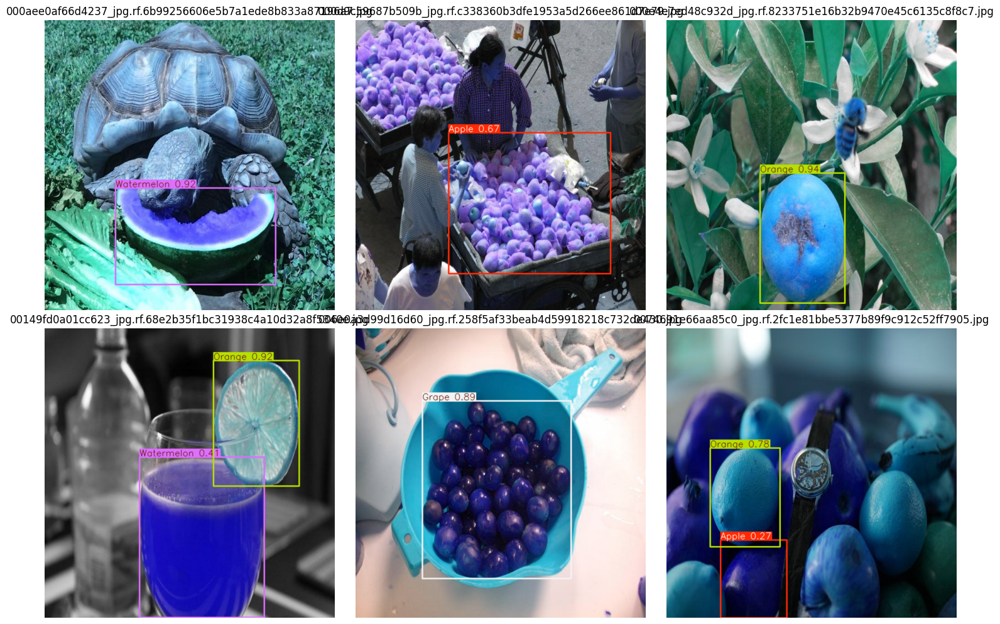

In [10]:
from ultralytics import YOLO
import os
from matplotlib import pyplot as plt
import math

# 1️⃣ تحميل النموذج
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة
TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# 3️⃣ مجلد لحفظ الصور بعد التنبؤ
OUTPUT_DIR = "/content/drive/MyDrive/fruit-detection/test/predicted_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# 4️⃣ اختيار الصور (أول 6 صور كمثال)
image_files = sorted(os.listdir(TEST_IMAGES))[:6]

# إعداد Grid
cols = 3
rows = math.ceil(len(image_files)/cols)
plt.figure(figsize=(15, 5*rows))

# 5️⃣ التنبؤ وعرض الصور في Grid وحفظها
for i, img_file in enumerate(image_files):
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path, conf=0.25, save=False)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # حفظ الصورة
    output_path = os.path.join(OUTPUT_DIR, img_file)
    plt.imsave(output_path, result_img)
    print(f"✅ تم حفظ الصورة المتنبأ عليها في: {output_path}")

    # عرض الصورة داخل Grid
    plt.subplot(rows, cols, i+1)
    plt.imshow(result_img)
    plt.title(img_file)
    plt.axis('off')

plt.tight_layout()
plt.show()



image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg: 640x640 1 Watermelon, 639.5ms
Speed: 6.2ms preprocess, 639.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


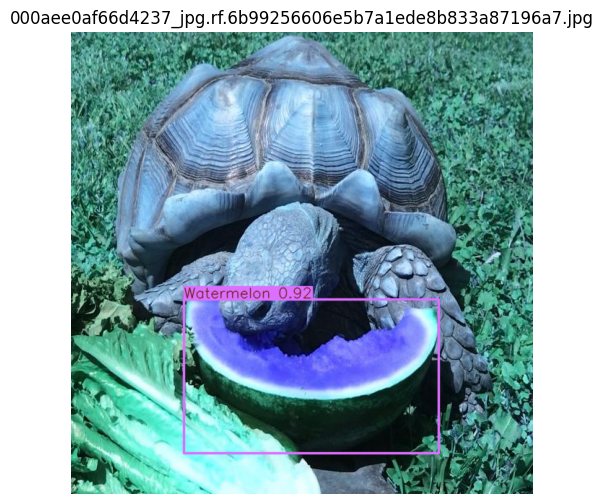

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000aee0af66d4237_jpg.rf.6b99256606e5b7a1ede8b833a87196a7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg: 640x640 1 Apple, 664.5ms
Speed: 5.0ms preprocess, 664.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


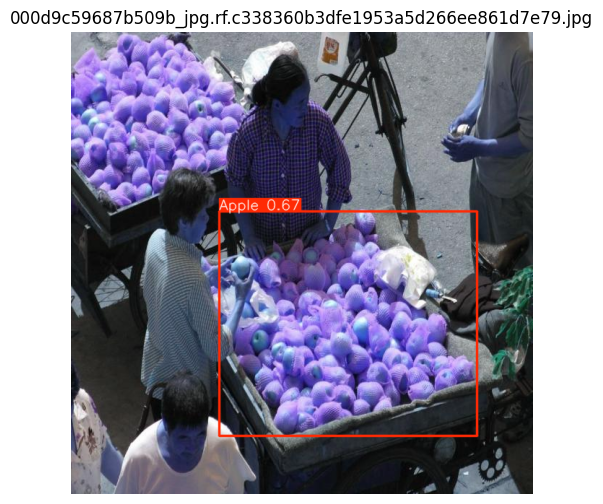

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000d9c59687b509b_jpg.rf.c338360b3dfe1953a5d266ee861d7e79.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg: 640x640 1 Orange, 674.4ms
Speed: 6.1ms preprocess, 674.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


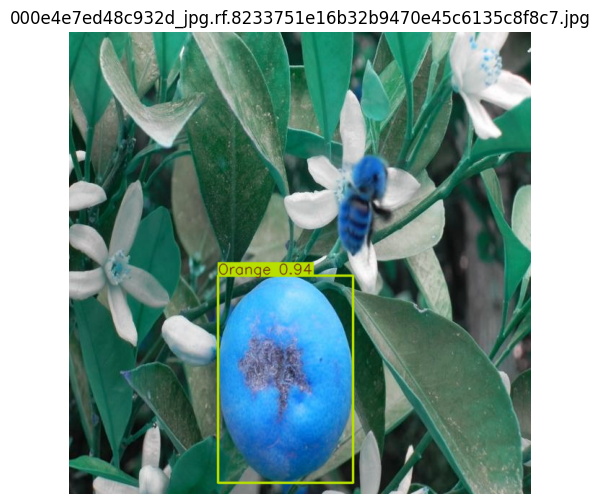

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00149fd0a01cc623_jpg.rf.68e2b35f1bc31938c4a10d32a8f5340e.jpg: 640x640 1 Orange, 1 Watermelon, 688.0ms
Speed: 3.6ms preprocess, 688.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


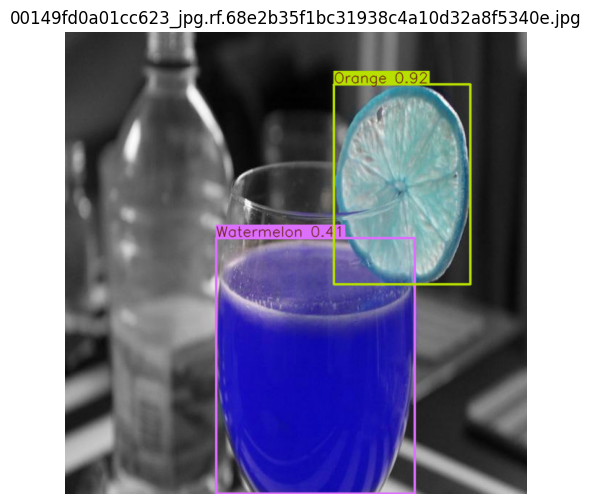

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/00149fd0a01cc623_jpg.rf.68e2b35f1bc31938c4a10d32a8f5340e.jpg

image 1/1 /content/drive/MyDrive/fruit-detection/test/images/006e0a3d99d16d60_jpg.rf.258f5af33beab4d59918218c732de430.jpg: 640x640 1 Grape, 672.6ms
Speed: 3.3ms preprocess, 672.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


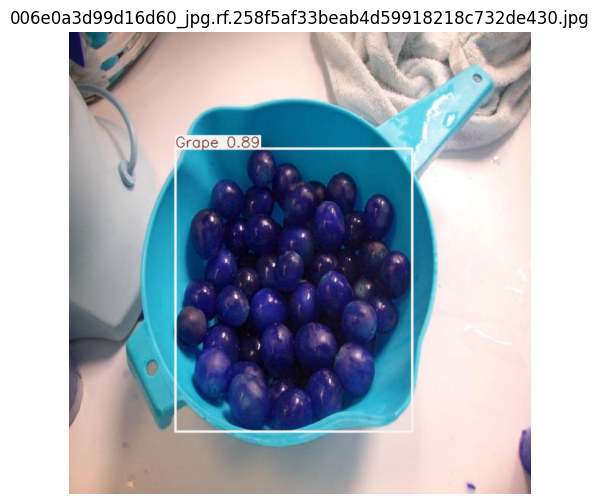

✅ تم حفظ الصورة المتنبأ عليها في: /content/drive/MyDrive/fruit-detection/test/predicted_images/006e0a3d99d16d60_jpg.rf.258f5af33beab4d59918218c732de430.jpg
🎉 تم الانتهاء من التنبؤ على الصور بنجاح!


In [11]:
from ultralytics import YOLO
import os
from matplotlib import pyplot as plt

# 1️⃣ تحميل النموذج من Drive مباشرة
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# 2️⃣ مسار الصور الجديدة
TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# 3️⃣ مجلد لحفظ الصور بعد التنبؤ
OUTPUT_DIR = "/content/drive/MyDrive/fruit-detection/test/predicted_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# 4️⃣ التنبؤ على الصور (أول 5 صورة)
image_files = sorted(os.listdir(TEST_IMAGES))[:5]

for i, img_file in enumerate(image_files):
    img_path = os.path.join(TEST_IMAGES, img_file)

    # التنبؤ بالصناديق
    results = model.predict(img_path, conf=0.2, save=False)

    # الحصول على الصورة مع الصناديق مطبوعة عليها
    result_img = results[0].plot()

    # حفظ الصورة
    output_path = os.path.join(OUTPUT_DIR, img_file)
    plt.imsave(output_path, result_img)

    # عرض الصورة في Colab
    plt.figure(figsize=(8,6))
    plt.imshow(result_img)
    plt.axis('off')
    plt.title(img_file)
    plt.show()

    print(f"✅ تم حفظ الصورة المتنبأ عليها في: {output_path}")

print("🎉 تم الانتهاء من التنبؤ على الصور بنجاح!")


In [12]:
import os

train_images = "/content/drive/MyDrive/fruit-detection/train/images"
valid_images = "/content/drive/MyDrive/fruit-detection/valid/images"
test_images = "/content/drive/MyDrive/fruit-detection/test/images"

print("Train images example:", os.listdir(train_images)[:5])
print("Valid images example:", os.listdir(valid_images)[:5])
print("Test images example:", os.listdir(test_images)[:5])


Train images example: ['c7da67ea4840319d_jpg.rf.971a1583b2399d7f9aef868a6a213821.jpg', 'cb5490c7586939ac_jpg.rf.aa0d0c5acaf213c866dd3185136c734e.jpg', 'c2c19be58ed7280b_jpg.rf.1893244edb969a4fde9d7c7f3baf9468.jpg', 'c3dcf8c741f6c138_jpg.rf.b1fa262a88ce35f88997f3a6e1f3294f.jpg', 'c7c82e0be3bd8995_jpg.rf.d1a04d08ef43ff068b99775b1b538e09.jpg']
Valid images example: ['0e427c3df6d2dec1_jpg.rf.d78fbe8a085150f7aeb0779d3809f999.jpg', '1618b3b677a7ca4d_jpg.rf.ee297208d10a4dade6be5ee269b960ca.jpg', '2f3ea519d2e47b8b_jpg.rf.f20772244940b59c25fe36650e619644.jpg', '0242b430afd08d2e_jpg.rf.cf199d39cad2d5c02c69aeb4214fa57a.jpg', '2dbf6a2b72b143b3_jpg.rf.0af9c38bb97e8ebf7785808104cf3207.jpg']
Test images example: ['0074691e66aa85c0_jpg.rf.2fc1e81bbe5377b89f9c912c52ff7905.jpg', '000e4e7ed48c932d_jpg.rf.8233751e16b32b9470e45c6135c8f8c7.jpg', '00b7cee6cbe6af50_jpg.rf.3a3cae04aadca322e29eafacce1af649.jpg', '00149fd0a01cc623_jpg.rf.68e2b35f1bc31938c4a10d32a8f5340e.jpg', '00a5ae275e1ebe39_jpg.rf.be4ae1c307a

In [13]:
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

print("✅ تم تحميل النموذج بنجاح")


✅ تم تحميل النموذج بنجاح


In [14]:
import os
import shutil

# مجلد الهدف لحفظ كل شيء
SAVE_DIR = "/content/drive/MyDrive/fruit-detection/saved_project"
os.makedirs(SAVE_DIR, exist_ok=True)

# 1️⃣ حفظ الصور المتنبأ عليها
PRED_DIR = "/content/drive/MyDrive/fruit-detection/test/predicted_images"
if os.path.exists(PRED_DIR):
    shutil.copytree(PRED_DIR, os.path.join(SAVE_DIR, "predicted_images"), dirs_exist_ok=True)

# 2️⃣ حفظ النموذج المدرب
MODEL_PATH = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
if os.path.exists(MODEL_PATH):
    shutil.copy(MODEL_PATH, os.path.join(SAVE_DIR, "best.pt"))

# 3️⃣ حفظ ملف data.yaml
DATA_YAML = "/content/drive/MyDrive/fruit-detection/data.yaml"
if os.path.exists(DATA_YAML):
    shutil.copy(DATA_YAML, os.path.join(SAVE_DIR, "data.yaml"))

# 4️⃣ حفظ أي ملفات نتائج أخرى (مثال: metrics.txt)
RESULTS_FILE = "/content/drive/MyDrive/fruit-detection/results/metrics.txt"
if os.path.exists(RESULTS_FILE):
    shutil.copy(RESULTS_FILE, os.path.join(SAVE_DIR, "metrics.txt"))

print(f"✅ كل شيء تم حفظه في: {SAVE_DIR}")


✅ كل شيء تم حفظه في: /content/drive/MyDrive/fruit-detection/saved_project



image 1/1 /content/drive/MyDrive/fruit-detection/test/images/95829269b2307c09_jpg.rf.ce1b62836a88123b246a16c7afc78f9b.jpg: 640x640 1 Watermelon, 830.6ms
Speed: 11.8ms preprocess, 830.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


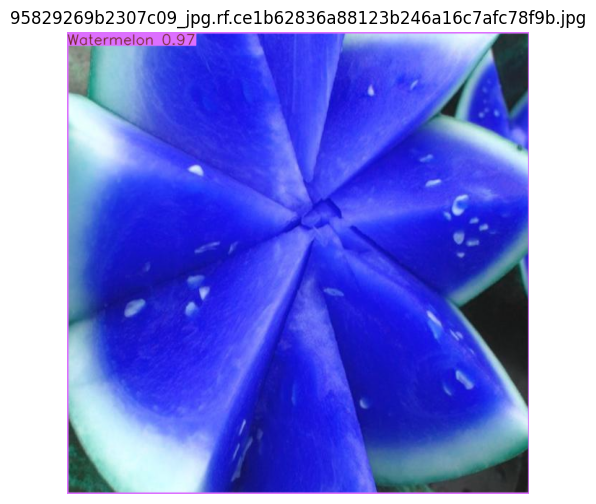


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/db8a5683be7eecad_jpg.rf.e23f393ae55cd5a45c7aedb8c5b297c7.jpg: 640x640 2 Grapes, 686.1ms
Speed: 6.8ms preprocess, 686.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


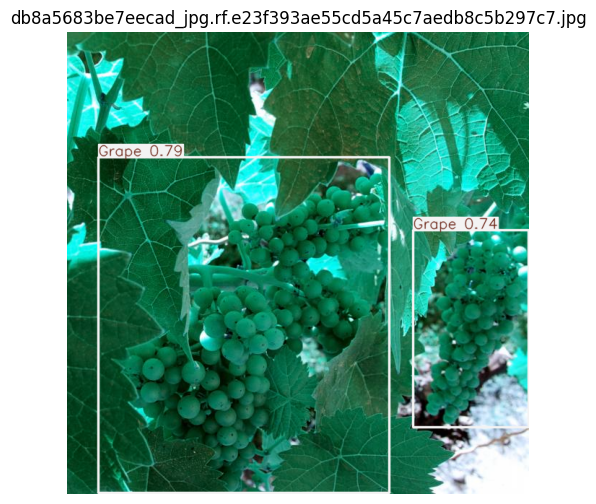


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/00a5ae275e1ebe39_jpg.rf.be4ae1c307aaeaa6d46752808eda2ad8.jpg: 640x640 1 Grape, 669.3ms
Speed: 4.7ms preprocess, 669.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


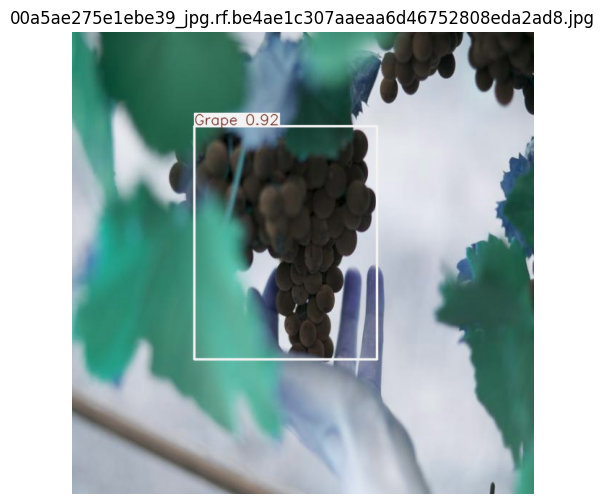


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/20118be1986a1ce2_jpg.rf.4edb4981da63c53bdf95c7c6ff84d747.jpg: 640x640 1 Banana, 640.2ms
Speed: 3.0ms preprocess, 640.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


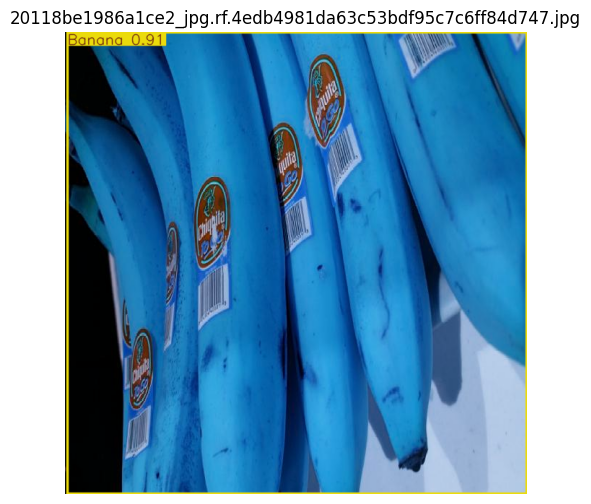


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/f484f9202f71a699_jpg.rf.06e911de1bf5542761b52a226ad1664d.jpg: 640x640 1 Grape, 1069.7ms
Speed: 9.2ms preprocess, 1069.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


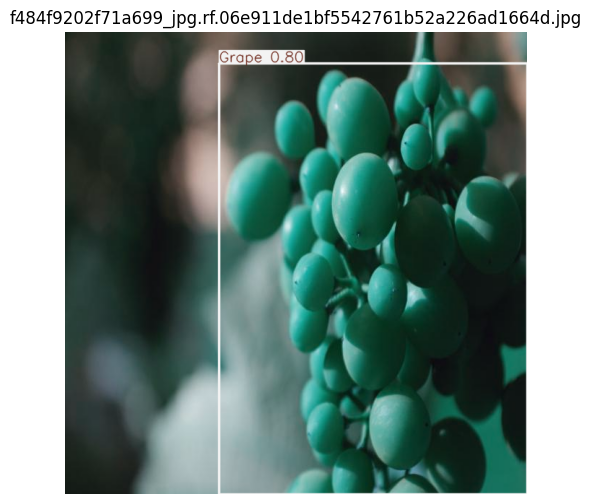

In [15]:
import os
import random
import matplotlib.pyplot as plt

TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# اختيار 5 صور عشوائية
image_files = os.listdir(TEST_IMAGES)
sample_images = random.sample(image_files, 5)

for img_name in sample_images:
    img_path = os.path.join(TEST_IMAGES, img_name)

    results = model.predict(img_path, conf=0.5)
    img = results[0].plot()

    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()


In [16]:
results = model.val(
    data="/content/drive/MyDrive/fruit-detection/data.yaml"
)

print("Precision:", results.box.mp)
print("Recall:", results.box.mr)
print("mAP50:", results.box.map50)
print("mAP50-95:", results.box.map)


Ultralytics 8.3.241 🚀 Python-3.12.12 torch-2.9.0+cpu CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.8±0.2 ms, read: 0.3±0.2 MB/s, size: 65.9 KB)
val: Scanning /content/drive/MyDrive/fruit-detection/valid/labels.cache... 914 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 914/914 1.0Mit/s 0.0s
val: /content/drive/MyDrive/fruit-detection/valid/images/3d3ddc3054b32eb7_jpg.rf.03e7789aaf5212e2634b84ef502e0832.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 58/58 15.6s/it 15:04
                   all        914       3227      0.633      0.475      0.517      0.355
                 Apple        188        557      0.612      0.472      0.516      0.374
                Banana        167        390      0.617      0.467      0.508      0.306
                 Grape        199        809       0.56      0.394      0.411      0.272
                Orange        197       1100      0.6


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/6c575166603ecf61_jpg.rf.40a75df0ecdf5900f213328b2c968980.jpg: 640x640 (no detections), 649.1ms
Speed: 3.9ms preprocess, 649.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


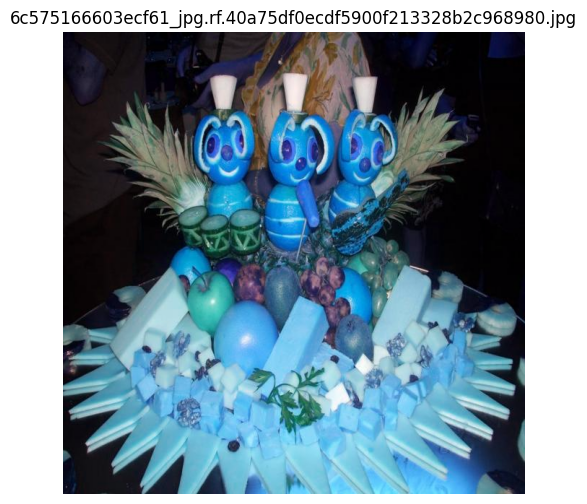


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/7339be19afff2750_jpg.rf.2808eb43c51820b342165624d3ab6726.jpg: 640x640 1 Watermelon, 720.1ms
Speed: 3.7ms preprocess, 720.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


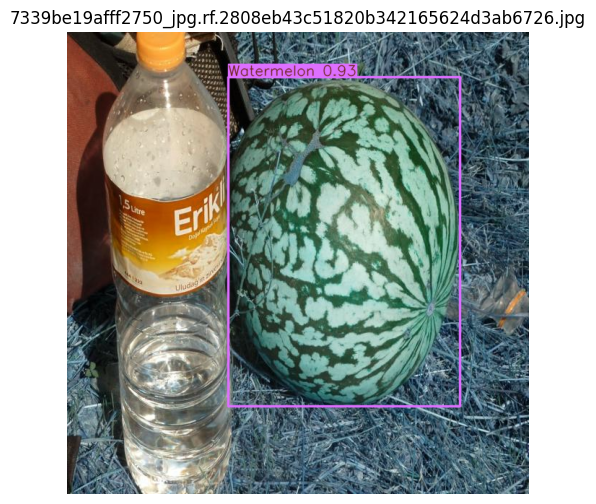


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/a9948144e2b7b4b8_jpg.rf.a738bc76f1d3854ea71fd3806e3ff009.jpg: 640x640 (no detections), 658.2ms
Speed: 3.9ms preprocess, 658.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


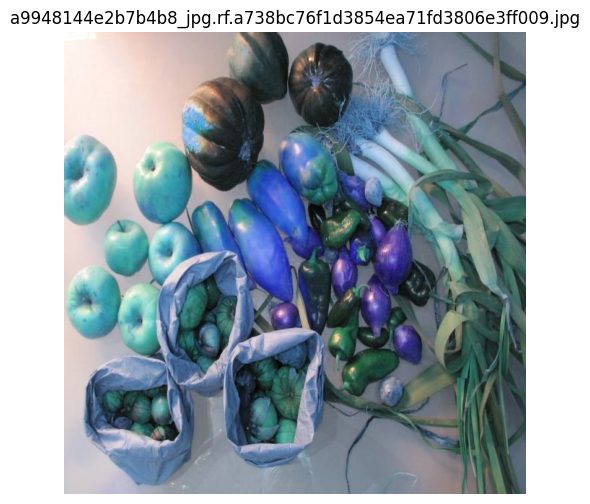


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/8b80f23218562b96_jpg.rf.dd4657b7523addc70586d77471c9cf8d.jpg: 640x640 1 Banana, 1231.3ms
Speed: 5.4ms preprocess, 1231.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


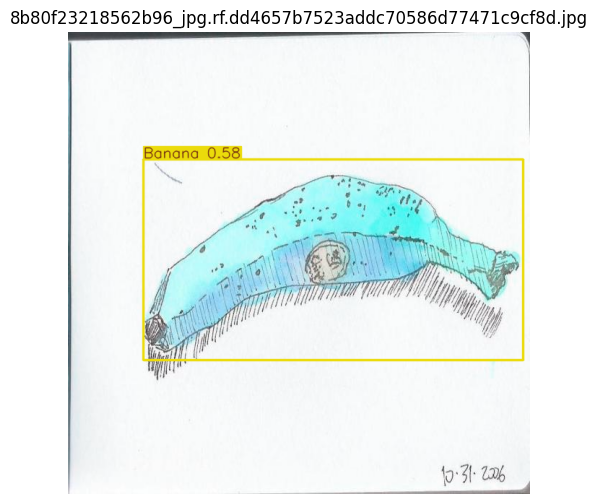


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/63a5e760593e4f23_jpg.rf.e8a7fa784114b34ceba40a3b3a81abb7.jpg: 640x640 1 Watermelon, 1160.9ms
Speed: 3.9ms preprocess, 1160.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


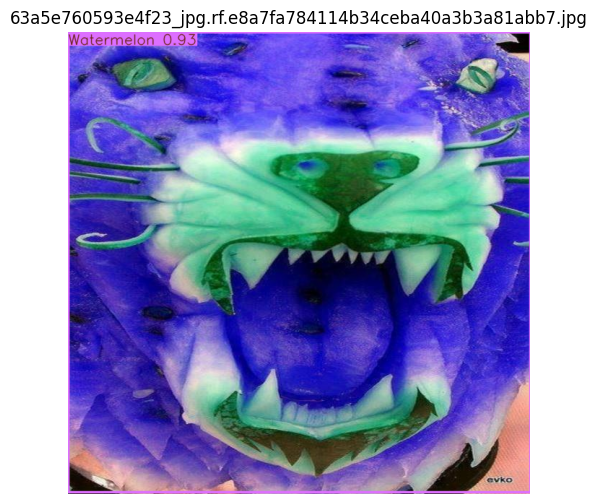


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/0415b6a36f3381ed_jpg.rf.6a8eabb046430e7851eff506647cf1a8.jpg: 640x640 1 Apple, 1 Grape, 759.8ms
Speed: 4.5ms preprocess, 759.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


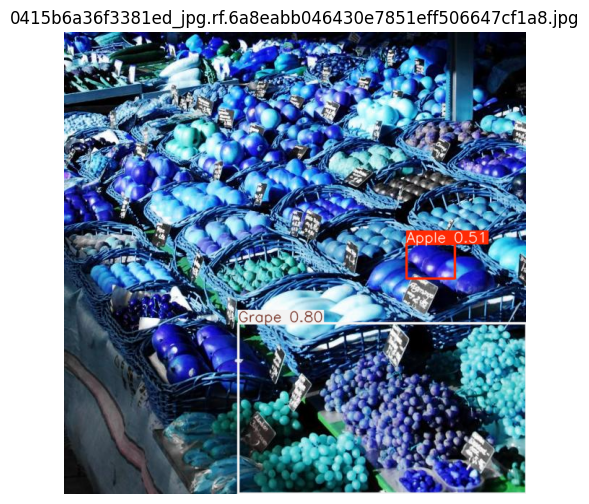


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/f5476da28ed4753d_jpg.rf.a55ae1ce55396406107c16db199ff42e.jpg: 640x640 1 Grape, 724.9ms
Speed: 4.1ms preprocess, 724.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


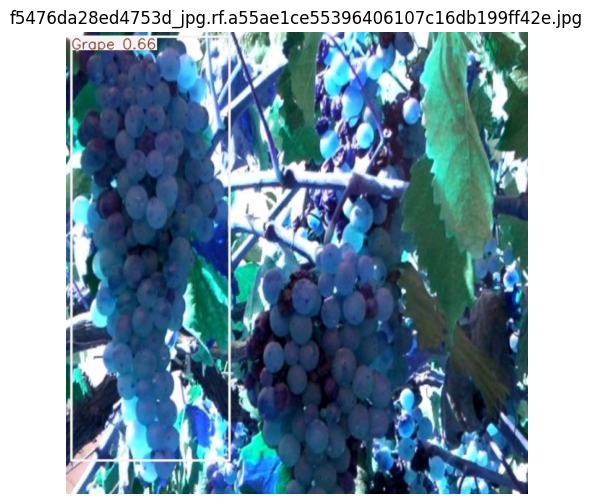


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/41433e029b3cb435_jpg.rf.cd7c080722bb0cddd62e4073abfce926.jpg: 640x640 2 Bananas, 995.4ms
Speed: 3.3ms preprocess, 995.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


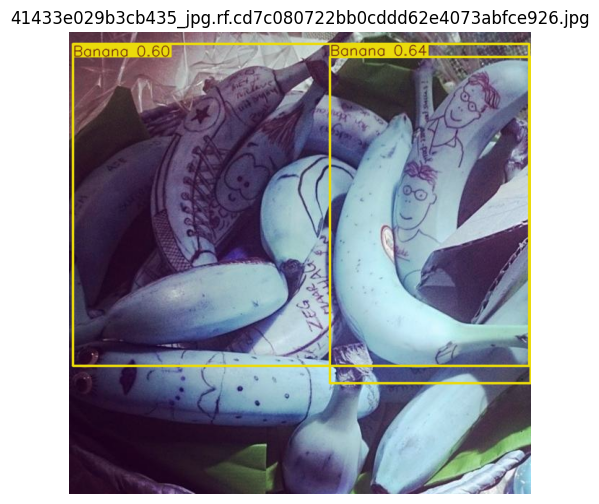


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/c49acd83ff688c11_jpg.rf.868f0e17db744dc96ad9c8c164c158de.jpg: 640x640 1 Apple, 975.9ms
Speed: 7.3ms preprocess, 975.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


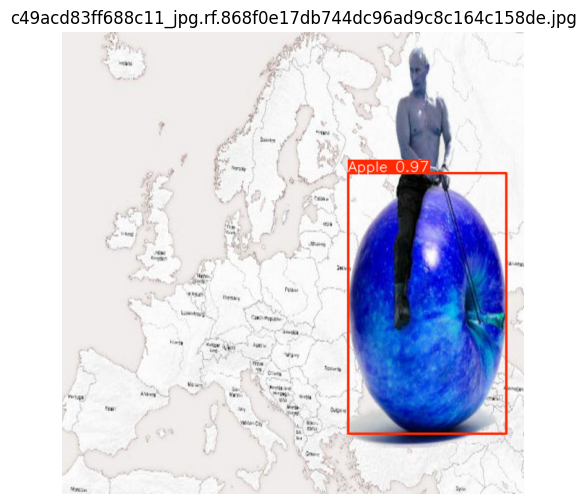


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/8c7af225915277bb_jpg.rf.94b4c443bd90d73fe04150a9cc193d06.jpg: 640x640 1 Apple, 1022.1ms
Speed: 3.4ms preprocess, 1022.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


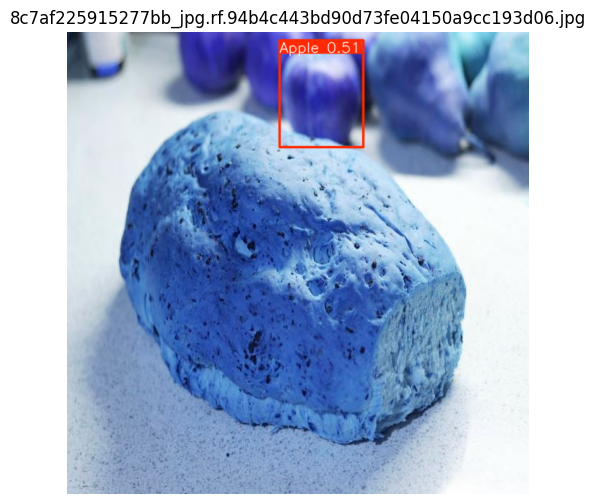


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/6c4e9a1311a28275_jpg.rf.4e865fab57e98ad2d204b0ffef99111e.jpg: 640x640 (no detections), 997.7ms
Speed: 5.6ms preprocess, 997.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


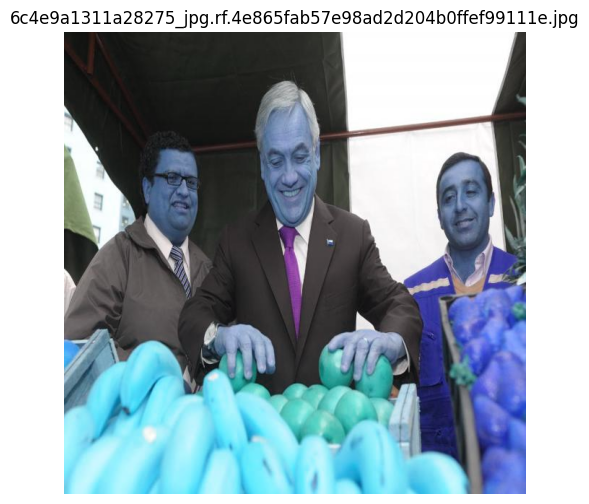


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/948d45839371aa63_jpg.rf.7ac531fab8a2d0288ed11e8860e23aae.jpg: 640x640 1 Apple, 963.1ms
Speed: 4.5ms preprocess, 963.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


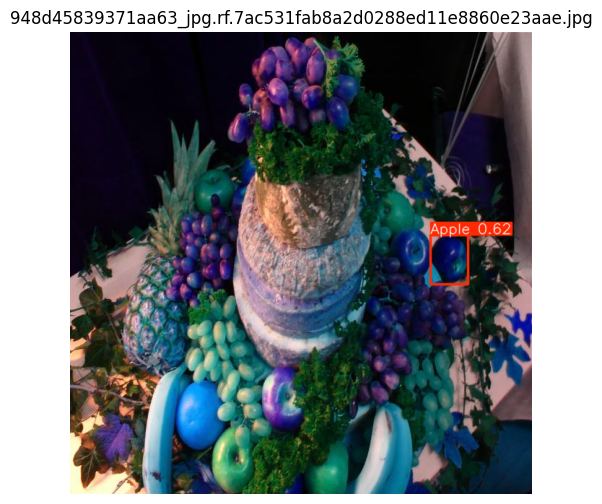


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/094cdccc6c0d1a47_jpg.rf.396cc6c8967fd0445f3d7e0881a83a70.jpg: 640x640 1 Watermelon, 752.6ms
Speed: 4.1ms preprocess, 752.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


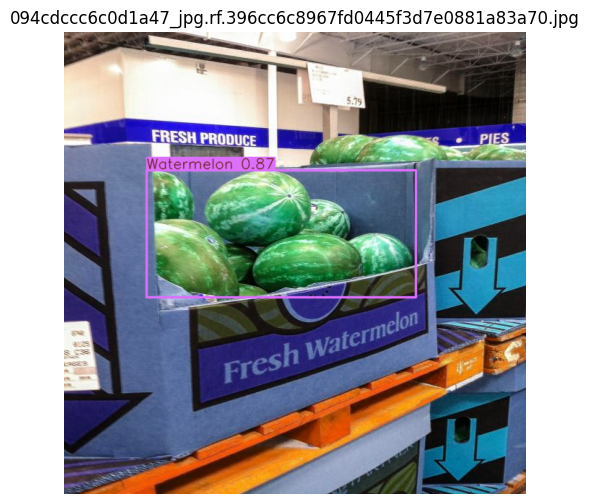


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/01918ed451cb9a4f_jpg.rf.a6773a8b304b6909fb5cf73e6390bc44.jpg: 640x640 7 Oranges, 758.4ms
Speed: 4.6ms preprocess, 758.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


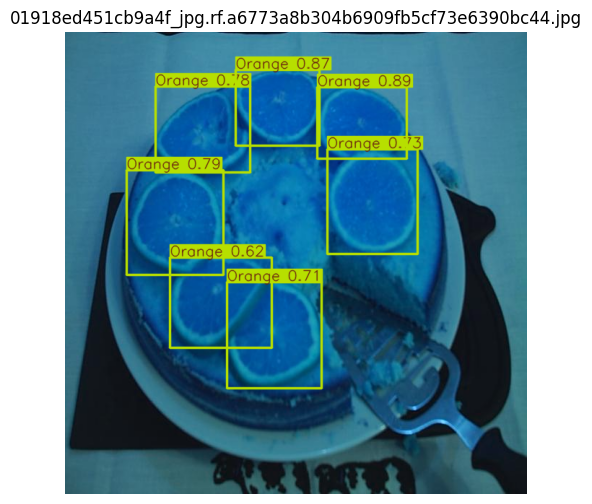


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/3038b7ea0b46de9b_jpg.rf.78ee70a39871fe8a7ae9dcc1fadb68bd.jpg: 640x640 1 Grape, 735.8ms
Speed: 4.6ms preprocess, 735.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


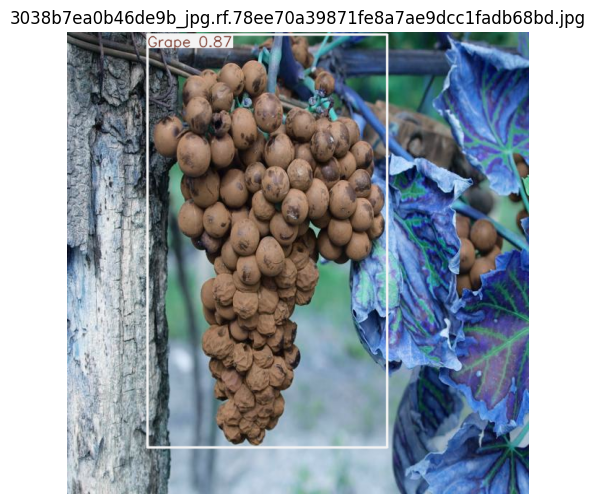


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/f484f9202f71a699_jpg.rf.06e911de1bf5542761b52a226ad1664d.jpg: 640x640 1 Grape, 734.1ms
Speed: 3.3ms preprocess, 734.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


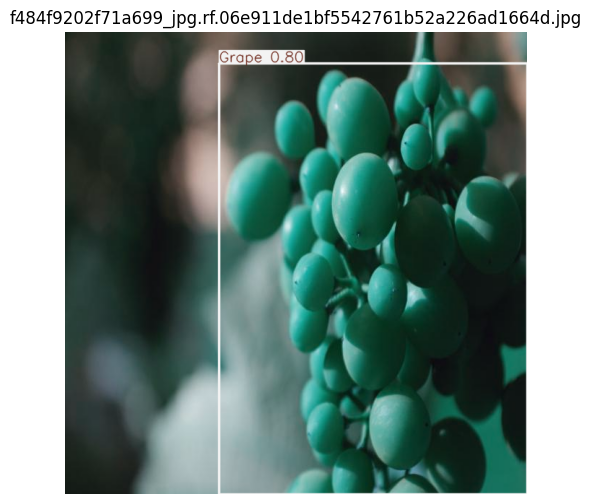


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/4f20cd20e4679344_jpg.rf.545a62551c3beaa8ad24687adddaaea4.jpg: 640x640 1 Grape, 719.3ms
Speed: 3.2ms preprocess, 719.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


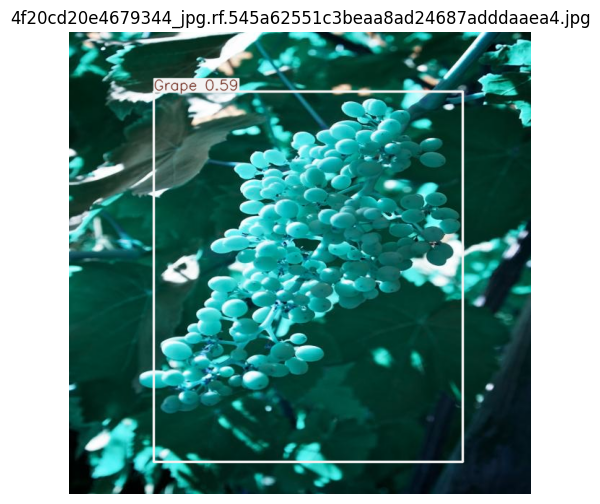


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/c097b6e1ae80fc02_jpg.rf.077547830675ee71375fc10ada88515b.jpg: 640x640 1 Apple, 776.3ms
Speed: 3.7ms preprocess, 776.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


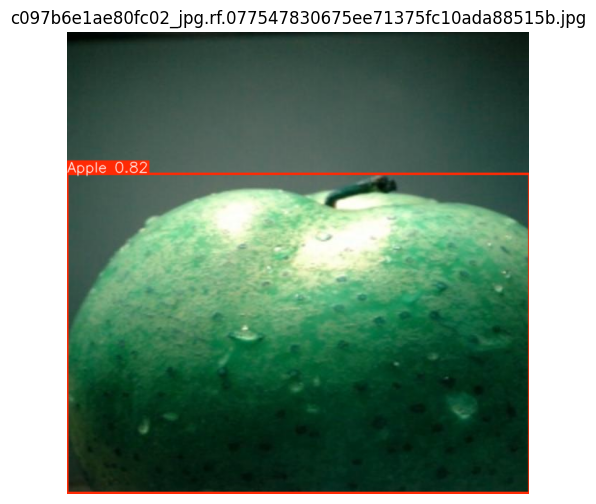


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/d2f3d934b8fc3897_jpg.rf.4157a2af878c56e076e948ea3538af87.jpg: 640x640 1 Apple, 784.9ms
Speed: 4.1ms preprocess, 784.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


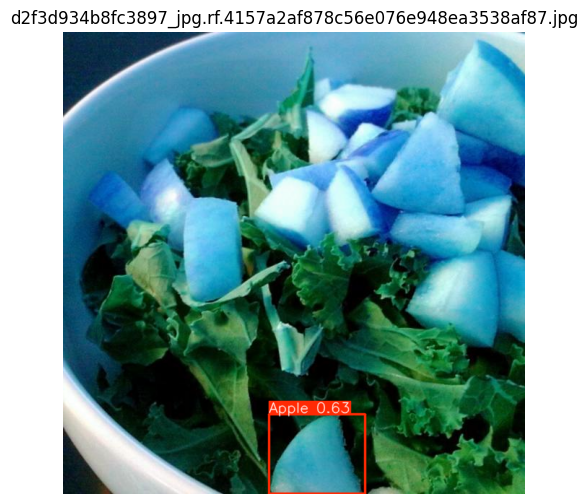


image 1/1 /content/drive/MyDrive/fruit-detection/test/images/9cbfacd061df0cb7_jpg.rf.2668ed3e2f1969feacdaa4bd2eca7b91.jpg: 640x640 1 Grape, 775.9ms
Speed: 3.7ms preprocess, 775.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


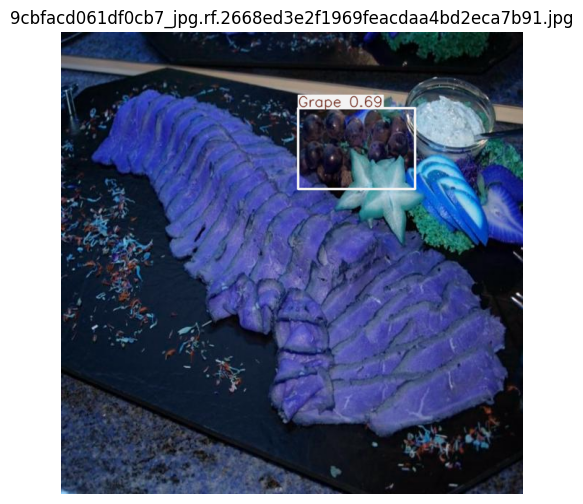

In [67]:
import os
import random
import matplotlib.pyplot as plt
from ultralytics import YOLO

# تحميل النموذج
model_path = "/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt"
model = YOLO(model_path)

# مسار صور الاختبار
TEST_IMAGES = "/content/drive/MyDrive/fruit-detection/test/images"

# اختيار 5 صور عشوائية
image_files = os.listdir(TEST_IMAGES)
sample_images = random.sample(image_files, 20)

for img_name in sample_images:
    img_path = os.path.join(TEST_IMAGES, img_name)

    # ⬅️ التحسين هنا: conf=0.5
    results = model.predict(img_path, conf=0.5)
    img = results[0].plot()

    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()


In [75]:
data_yaml_content = """
path: /content/drive/MyDrive/fruit-detection

train: train/images
val: valid/images
test: test/images

nc: 6
names:
  - Apple
  - Banana
  - Grape
  - Orange
  - Pineapple
  - Watermelon
"""

with open("/content/drive/MyDrive/fruit-detection/data.yaml", "w") as f:
    f.write(data_yaml_content)

print("✅ تم إنشاء data.yaml بنجاح")


✅ تم إنشاء data.yaml بنجاح


In [1]:
!pip install gradio


In [2]:
print(open("/content/drive/MyDrive/fruit-detection/data.yaml").read())



names:
- Apple
- Banana
- Grape
- Orange
- Pineapple
- Watermelon
nc: 6
train: /content/drive/MyDrive/fruit-detection/train/images
val: /content/drive/MyDrive/fruit-detection/valid/images
test: /content/drive/MyDrive/fruit-detection/test/images



In [18]:
fruit_yolov8_full_results/results.png


NameError: name 'fruit_yolov8_full_results' is not defined

In [17]:
import gradio as gr
from ultralytics import YOLO
import numpy as np
from collections import Counter

# تحميل النموذج
model = YOLO("/content/drive/MyDrive/fruit_yolov8_full_results/weights/best.pt")

def detect_and_count(image):
    results = model.predict(image, conf=0.5)
    r = results[0]

    # الصورة مع الصناديق
    img = r.plot()

    # عدّ الأصناف
    class_ids = r.boxes.cls.cpu().numpy().astype(int)
    names = r.names
    counts = Counter([names[i] for i in class_ids])

    # تحويل العدّ إلى نص
    count_text = "\n".join([f"{k}: {v}" for k, v in counts.items()])
    if count_text == "":
        count_text = "No fruits detected"

    return img, count_text

# الواجهة
interface = gr.Interface(
    fn=detect_and_count,
    inputs=gr.Image(type="numpy", label="Upload Fruit Image"),
    outputs=[
        gr.Image(type="numpy", label="Detection Result"),
        gr.Textbox(label="Fruit Count")
    ],
    title="Fruit Detection & Counting (YOLOv8)",
    description="Upload an image to detect and count fruits using a YOLOv8 model."
)

interface.launch()


It looks like you are running Gradio on a hosted Jupyter notebook, which requires `share=True`. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://6337c2c89ddc02480f.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
